Generative adversarial networks (GANs), introduced in 2014 by Goodfellow, are for learning latent spaces of images. They enable the generation of fairly realistic synthetic images by forcing the generated images to be statistically almost indistinguishable from real ones.
A GAN is made of two parts:
*  Generator network—Takes as input a random vector (a random point in the
    latent space), and decodes it into a synthetic image
*  Discriminator network (or adversary)—Takes as input an image (real or synthetic),
    and predicts whether the image came from the training set or was created by
    the generator network.

  A GAN consists of a generator network coupled with a discriminator network.
The discriminator is trained to differenciate between the output of the generator
and real images from a training dataset, and the generator is trained to fool the
discriminator. Remarkably, the generator nevers sees images from the training
set directly; the information it has about the data comes from the discriminator.
 GANs are difficult to train, because training a GAN is a dynamic process rather
than a simple gradient descent process with a fixed loss landscape. Getting a
GAN to train correctly requires using a number of heuristic tricks, as well as
extensive tuning.

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.layers import LeakyReLU, BatchNormalization, Conv2D, Add, Layer, Conv2DTranspose, Activation, ZeroPadding2D, Input
from keras.models import Model
from keras.activations import *
from keras.layers import *
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
print(tf.__version__)

Number of replicas: 1
2.13.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
# set your Google Drive folder path
DRIVE_FOLDER = '/content/drive/My Drive/'
# List all files and folders in the directory
for filename in os.listdir(DRIVE_FOLDER):
    print(filename)

Colab Notebooks
CIFAR-10
Part1-Build Deep_Architecture .gdoc
Computer_Vision
monet_jpg
photo_jpg
gandido_generator.h5
input_photo_0.png
gandido_transformation_0.png
input_photo_1.png
gandido_transformation_1.png
input_photo_2.png
gandido_transformation_2.png
input_photo_3.png
gandido_transformation_3.png
input_photo_4.png
gandido_transformation_4.png
input_photo_5.png
gandido_transformation_5.png
input_photo_6.png
gandido_transformation_6.png
input_photo_7.png
gandido_transformation_7.png
input_photo_8.png
gandido_transformation_8.png
input_photo_9.png
gandido_transformation_9.png
zurich.jpeg
clear_images
louvre.jpg
starry_night.jpg
image_0.jpg
your_folder
856047.jpg


In [ ]:
import numpy as np
import pandas as pd
import cv2
import math
import random
import albumentations as A
import os
for dirname, _, filenames in os.walk('/content/drive/My Drive/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

Streaming output truncated to the last 5000 lines.
/content/drive/My Drive/photo_jpg/129823154f.jpg
/content/drive/My Drive/photo_jpg/31ebef8c4c.jpg
/content/drive/My Drive/photo_jpg/055e5dca6e.jpg
/content/drive/My Drive/photo_jpg/1eaa4a27c8.jpg
/content/drive/My Drive/photo_jpg/49a9692a0e.jpg
/content/drive/My Drive/photo_jpg/4069eee71a.jpg
/content/drive/My Drive/photo_jpg/4707b03a08.jpg
/content/drive/My Drive/photo_jpg/5f02c26178.jpg
/content/drive/My Drive/photo_jpg/76ef022161.jpg
/content/drive/My Drive/photo_jpg/403a9eb385.jpg
/content/drive/My Drive/photo_jpg/569ed795ec.jpg
/content/drive/My Drive/photo_jpg/65a09899f8.jpg
/content/drive/My Drive/photo_jpg/394a38353e.jpg
/content/drive/My Drive/photo_jpg/098b35d919.jpg
/content/drive/My Drive/photo_jpg/11068aa40b.jpg
/content/drive/My Drive/photo_jpg/69e5be6684.jpg
/content/drive/My Drive/photo_jpg/418d1c582c.jpg
/content/drive/My Drive/photo_jpg/271ec1348b.jpg
/content/drive/My Drive/photo_jpg/19e7940d94.jpg
/content/drive/My 

In [ ]:
def set_seed(seed):
    random.seed(seed)
    os.environ["PYTHONHASHSEED"] = str(seed)
    np.random.seed(seed)

SEED = 1111
set_seed(SEED)

In [ ]:
BASE_PATH = '/content/drive/My Drive/'
MONET_PATH = os.path.join(BASE_PATH, 'monet_jpg')
PHOTO_PATH = os.path.join(BASE_PATH, 'photo_jpg')

In [ ]:
def load_images(paths):
    images = []
    for img in paths:
        try:
            img = cv2.imread(img)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        except:
            print("Could not load {}".format(img))
        images.append(img)
    return images


def show_folder_info(path):
    d_image_sizes = {}
    for image_name in os.listdir(path):
        image = cv2.imread(os.path.join(path, image_name))
        d_image_sizes[image.shape] = d_image_sizes.get(image.shape, 0) + 1

    for size, count in d_image_sizes.items():
        print(f'shape: {size}\tcount: {count}')

def visualize_images(images):
    plt.figure(figsize=(16,16))

    w = int(len(images) ** .5)
    h = math.ceil(len(images) / w)


    for idx, image in enumerate(images):

        plt.subplot(h, w, idx + 1)
        plt.imshow(image)
        plt.axis('off')

    plt.show()

In [ ]:
MONET_IMAGES = [os.path.join(MONET_PATH, file) for file in os.listdir(MONET_PATH)]
monet_images = load_images(MONET_IMAGES)

PHOTO_IMAGES = [os.path.join(PHOTO_PATH, file) for file in os.listdir(PHOTO_PATH)]
photo_images = load_images(PHOTO_IMAGES)

## Monet Paintings

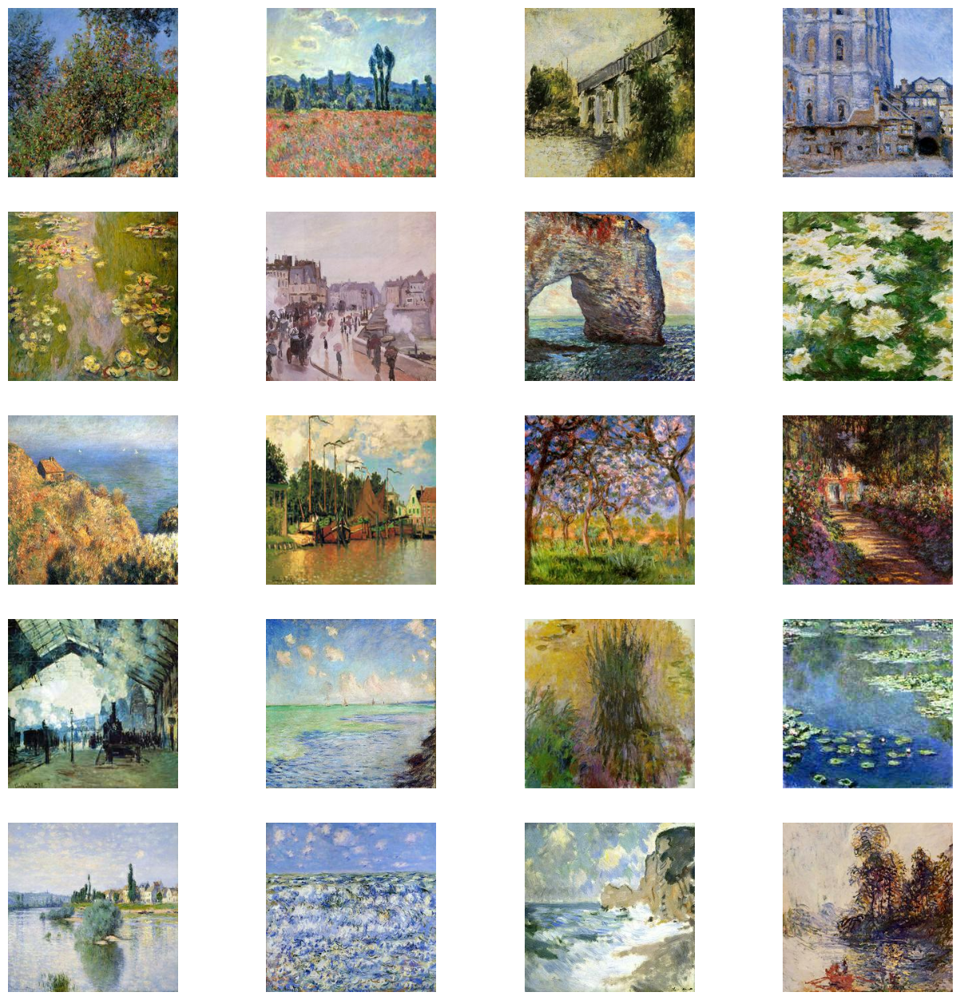

In [ ]:
import matplotlib.pyplot as plt
visualize_images(random.sample(monet_images,20))

## Photos

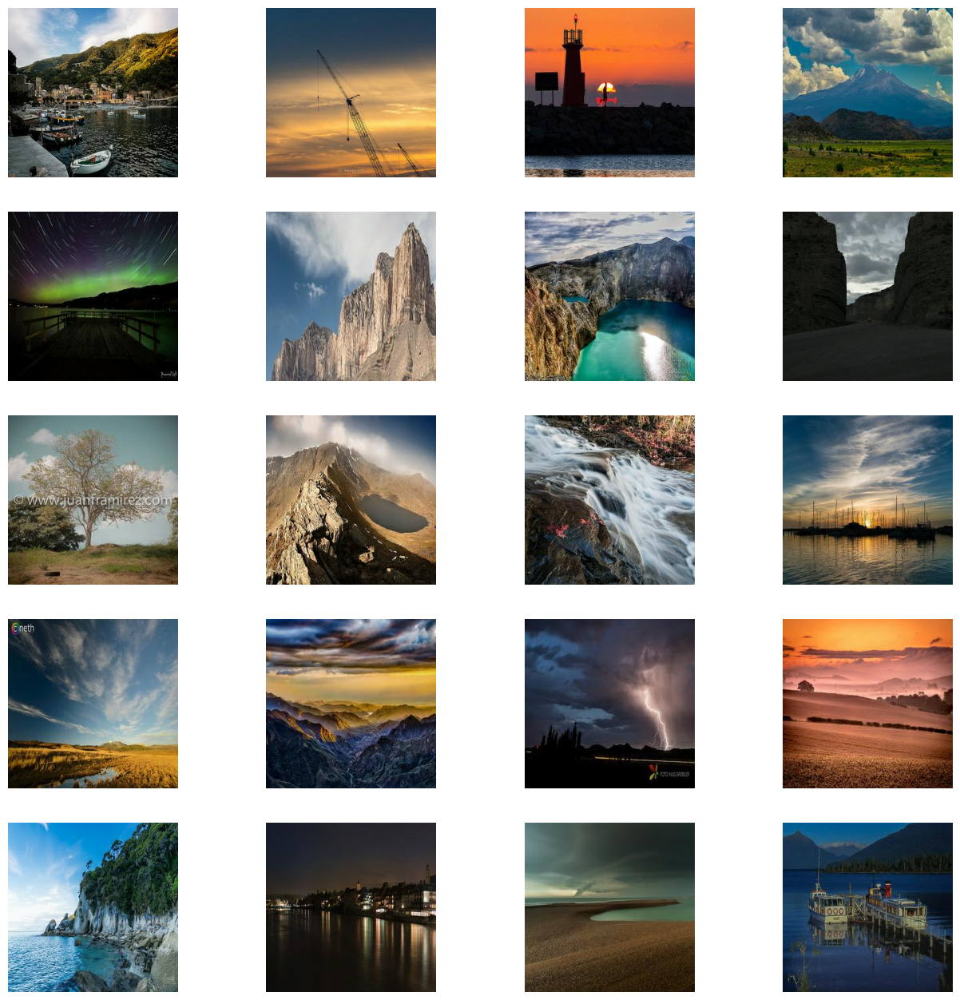

In [ ]:
visualize_images(random.sample(photo_images,20))

## Grayscale

In [ ]:
def grayscale_visualization(image_path, figsize=(8, 4)):
    plt.figure(figsize=figsize)

    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    tmp_img = np.full_like(img, 0)
    for i in range(3):
        tmp_img[:, :, i] = img.mean(axis=-1)
    plt.imshow(tmp_img)
    plt.axis('off')


    plt.show()

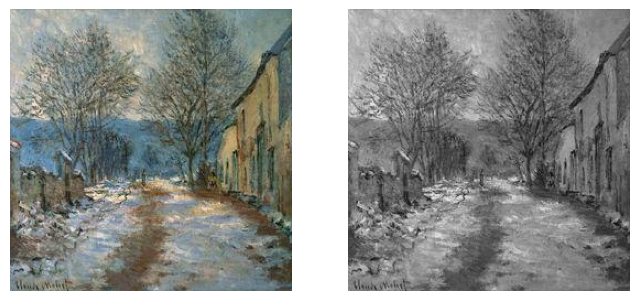

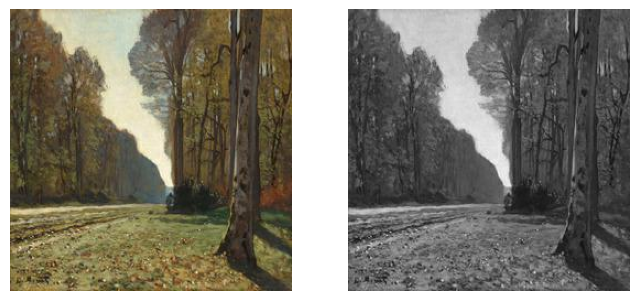

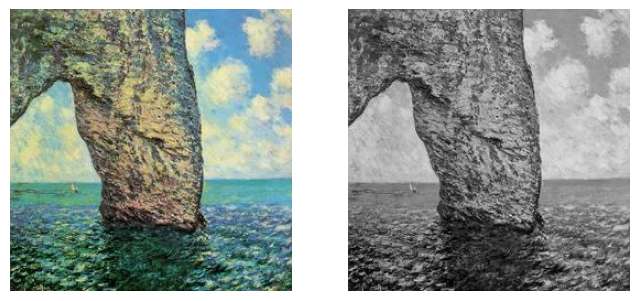

In [ ]:
img_path = '/content/drive/My Drive/monet_jpg/5c79cfe0b3.jpg'
grayscale_visualization(img_path)

img_path = '/content/drive/My Drive/monet_jpg/de6f71b00f.jpg'
grayscale_visualization(img_path)

img_path = '/content/drive/My Drive/monet_jpg/6bbe0e63c6.jpg'
grayscale_visualization(img_path)

## Augmentation (Blur)

In [ ]:
def plot_simple_augmentation(image_path, transform):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(img)
    plt.axis("off")

    plt.subplot(1, 2, 2)
    x = transform(image=img)["image"]
    plt.imshow(x)
    plt.axis("off")

    plt.show()

def plot_multiple_augmentation(image_path, transform):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 10))

    plt.subplot(2, 2, 1)
    plt.imshow(img)
    plt.axis("off")

    plt.subplot(2, 2, 2)
    x = transform(image=img)["image"]
    plt.imshow(x)
    plt.axis("off")

    plt.subplot(2, 2, 3)
    x = transform(image=img)["image"]
    plt.imshow(x)
    plt.axis("off")

    plt.subplot(2, 2, 4)
    x = transform(image=img)["image"]
    plt.imshow(x)
    plt.axis("off")

    plt.show()

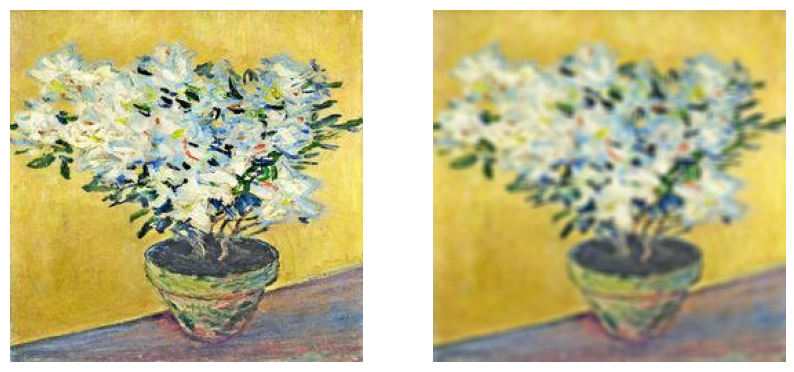

In [ ]:
transform = A.Compose(
    [
        A.Blur(p=1.0, blur_limit=(5, 5)),
    ]
)

plot_simple_augmentation("/content/drive/My Drive/monet_jpg/85580214be.jpg", transform)

## Augmentation (Clahe)

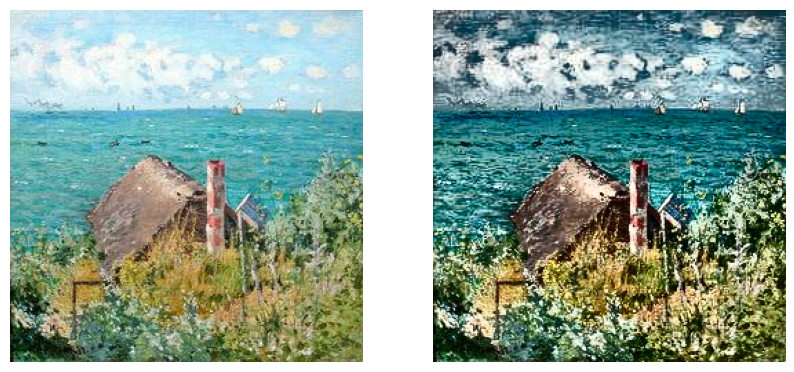

In [ ]:
transform = A.CLAHE(p=1.0, clip_limit=(10, 10), tile_grid_size=(3, 3))

plot_simple_augmentation("/content/drive/My Drive/monet_jpg/b1310da865.jpg", transform)

## Augmentation (CenterCrop)

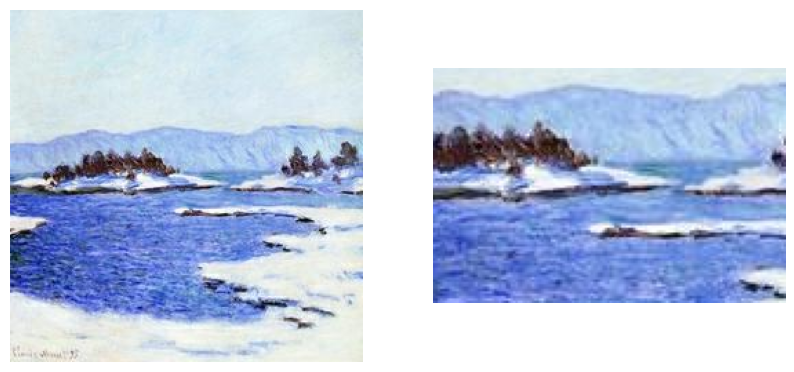

In [ ]:
transform = A.CenterCrop(p=1.0, height=100, width=150)

plot_simple_augmentation("/content/drive/My Drive/monet_jpg/cd6623d07d.jpg", transform)

## Augmentation (ChanelDropout)

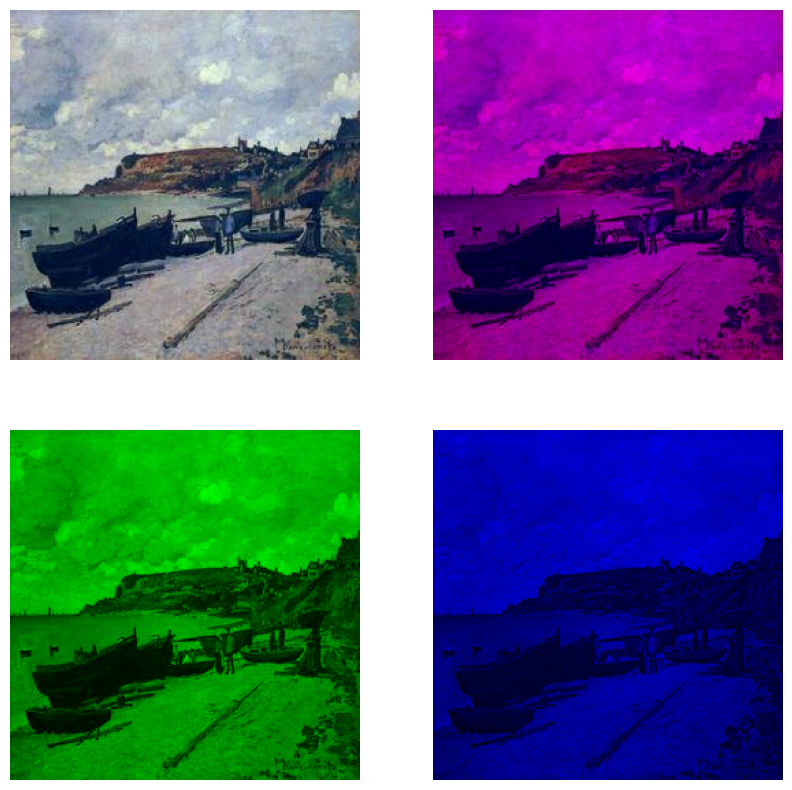

In [ ]:
transform = A.ChannelDropout(p=1.0, channel_drop_range=(1, 2), fill_value=0)

plot_multiple_augmentation("/content/drive/My Drive/monet_jpg/e9f686534b.jpg", transform)

## Augmentation (ChanelShuffle)

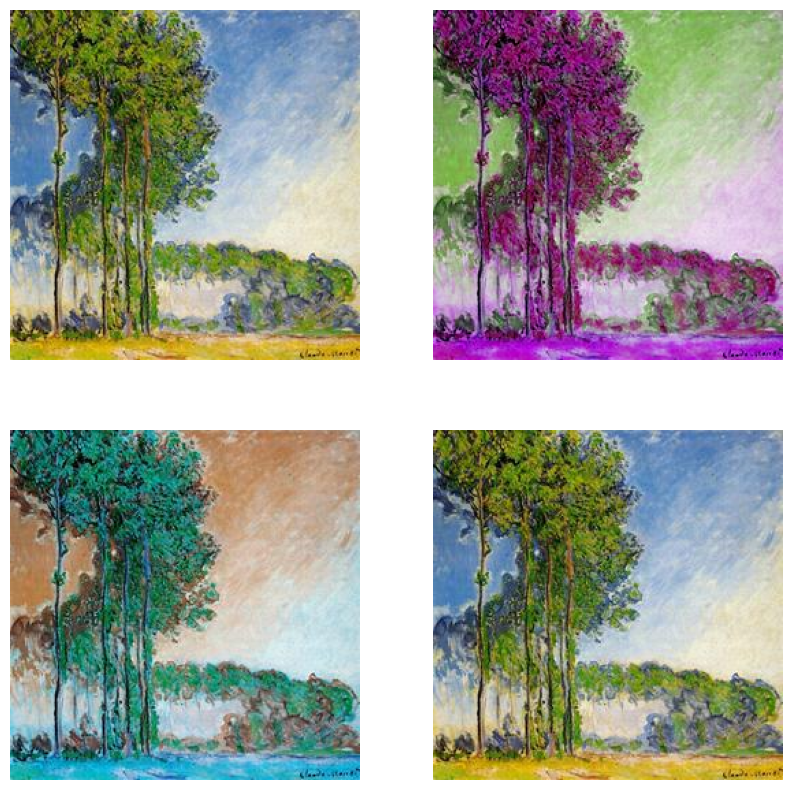

In [ ]:
transform = A.ChannelShuffle(p=1.0)

plot_multiple_augmentation("/content/drive/My Drive/monet_jpg/052a77c020.jpg", transform)

## Augmentaion (Downscale)

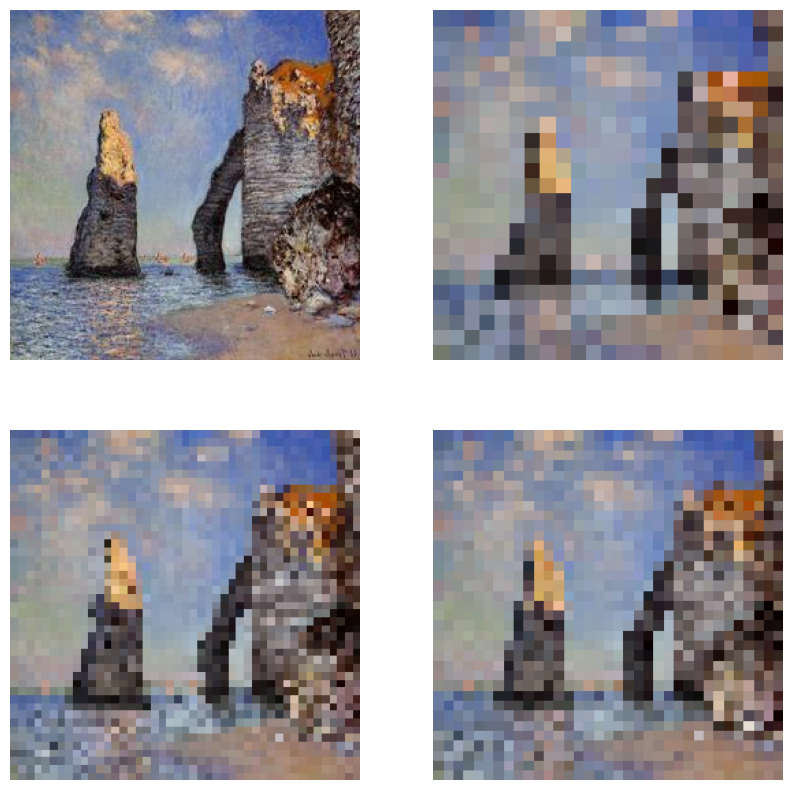

In [ ]:
transform = A.Downscale(
    p=1.0, scale_min=0.01, scale_max=0.20, interpolation=0,
)

plot_multiple_augmentation(
    "/content/drive/My Drive/monet_jpg/990ed28f62.jpg",
    transform,
)

## Augmentation (Equalize)

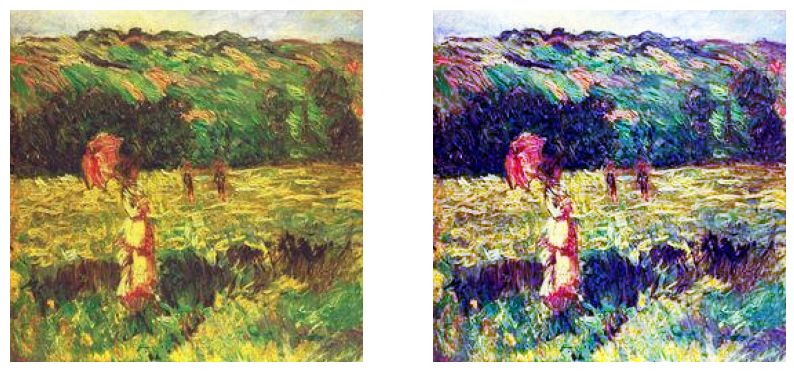

In [ ]:
transform = A.Equalize(
    p=1.0, mode='cv', by_channels=True,
)

plot_simple_augmentation(
    "/content/drive/My Drive/monet_jpg/8c8011c291.jpg",
    transform,
)

## Augmentation (GaussNoise)

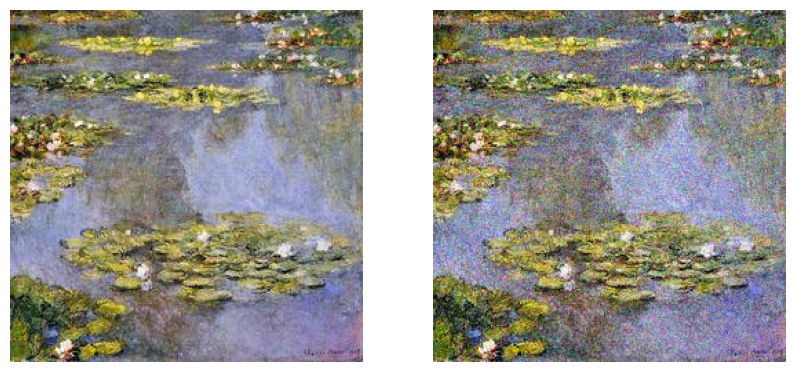

In [ ]:
transform = A.GaussNoise(
    p=1.0, var_limit=(500.0, 500.0),
)

plot_simple_augmentation(
    "/content/drive/My Drive/monet_jpg/f4413e97bd.jpg",
    transform,
)

## Augmentation (HueSaturationValue)

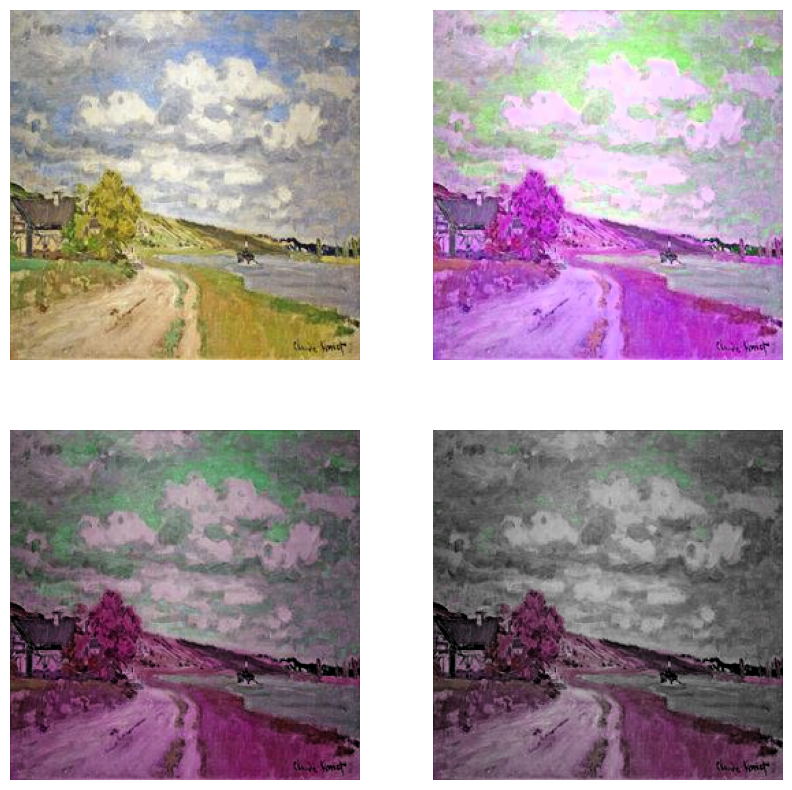

In [ ]:
transform = A.HueSaturationValue(
    p=1.0,
    hue_shift_limit=(-100, 100),
    sat_shift_limit=(-100, 100),
    val_shift_limit=(-100, 100),
)

plot_multiple_augmentation(
    "/content/drive/My Drive/monet_jpg/7341d96c1d.jpg",
    transform,
)

## Augmentation (ISONoise)

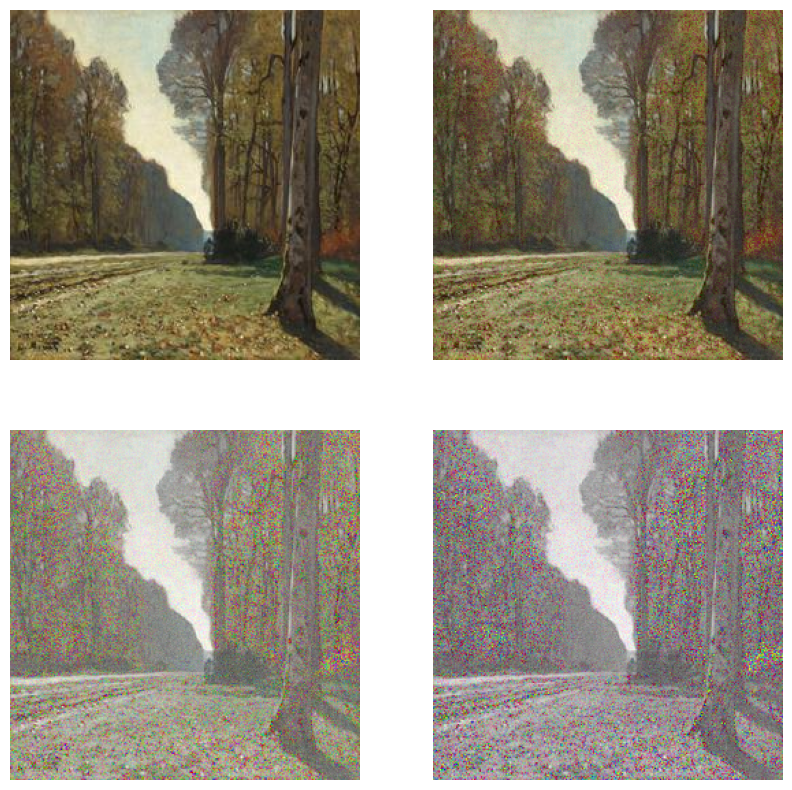

In [ ]:
transform = A.ISONoise(
    p=1.0, intensity=(0.0, 2.0), color_shift=(0.0, 1.0)
)

plot_multiple_augmentation(
    "/content/drive/My Drive/monet_jpg/de6f71b00f.jpg",
    transform,
)

## Augmentation (MotionBlur)

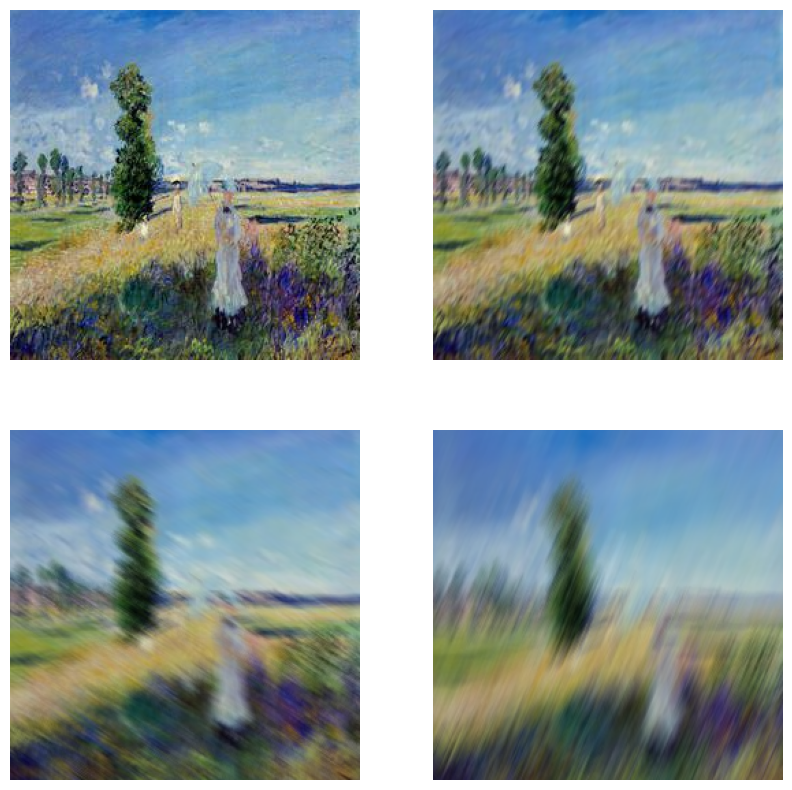

In [ ]:
transform = A.MotionBlur(
    p=1.0, blur_limit=(3, 49),allow_shifted=True
)

plot_multiple_augmentation(
    "/content/drive/MyDrive/monet_jpg/4e05523825.jpg",
    transform,
)

## Augmentation (MultiplicativeNoise)

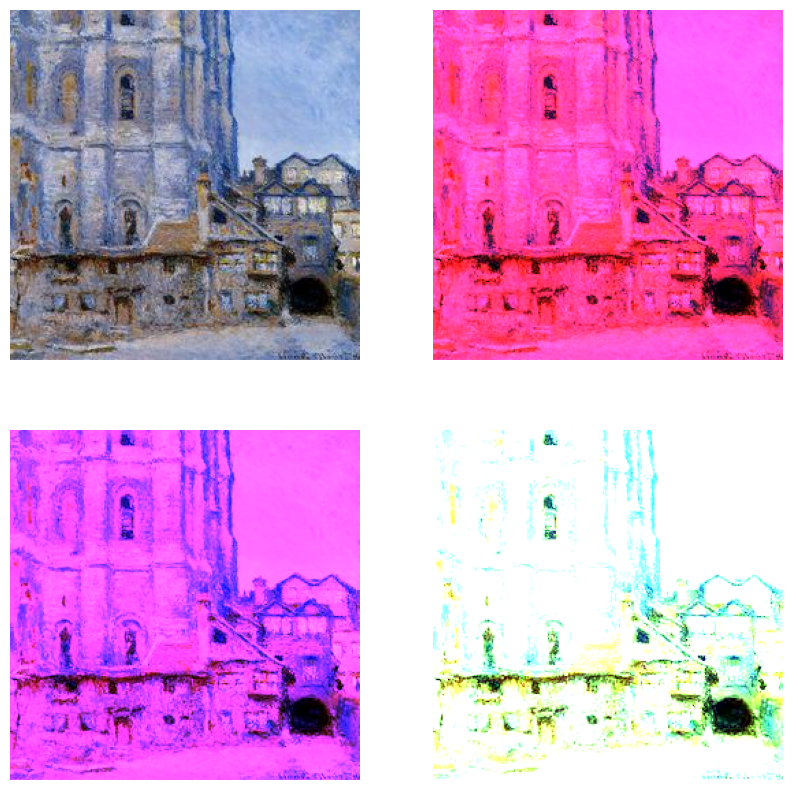

In [ ]:
transform = A.MultiplicativeNoise(
    p=1.0, multiplier=(0.1, 5.0), per_channel=True, elementwise=False,
)

plot_multiple_augmentation(
    "/content/drive/My Drive/monet_jpg/066fe4cbaa.jpg",
    transform,
)

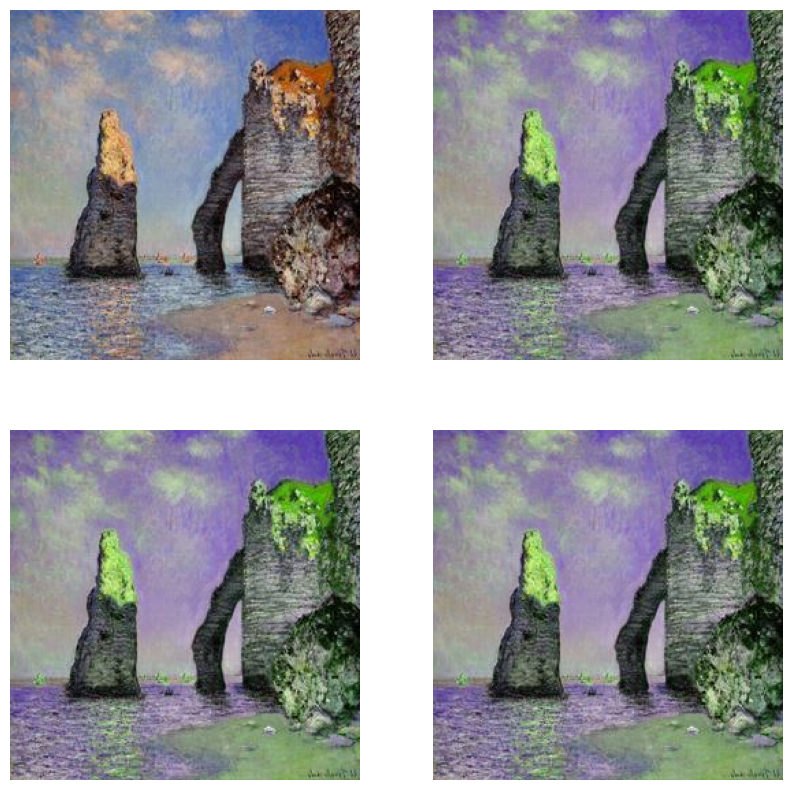

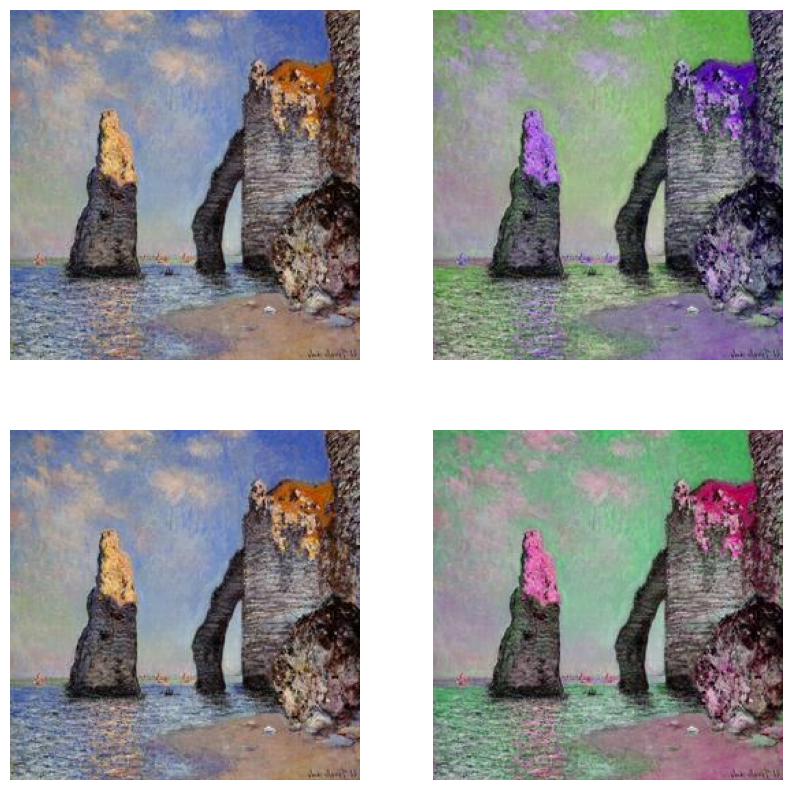

In [ ]:
transform = A.ChannelShuffle(p=1.0)

plot_multiple_augmentation("/content/drive/My Drive/monet_jpg/990ed28f62.jpg", transform)

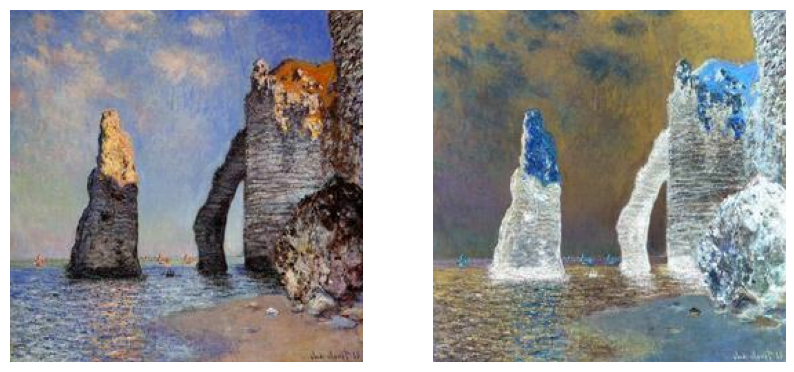

In [ ]:


transform = A.InvertImg(
    p=1.0,
)

plot_simple_augmentation(
    "/content/drive/My Drive/monet_jpg/990ed28f62.jpg",
    transform,
)



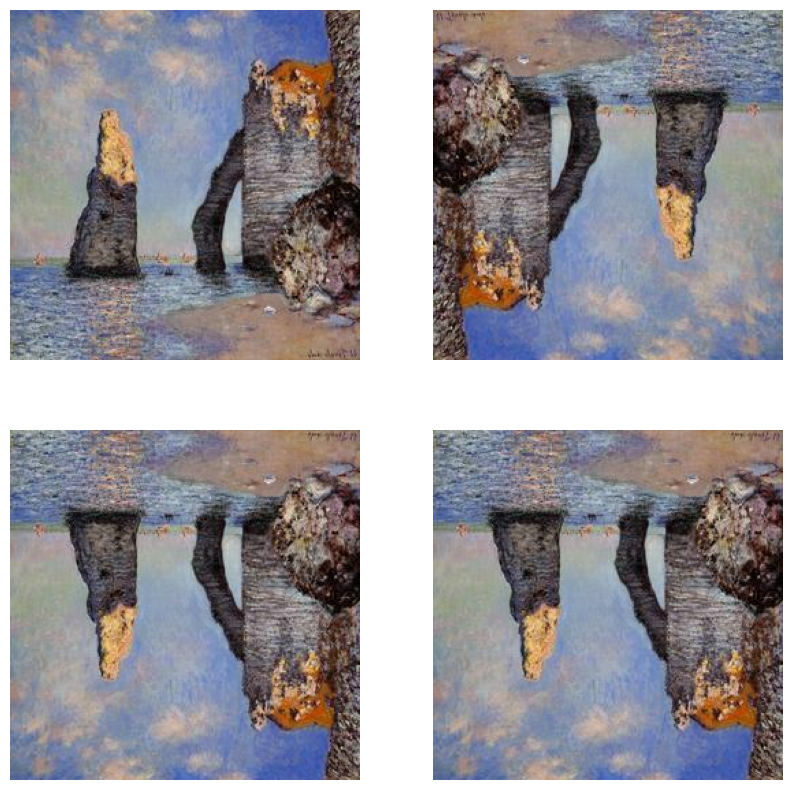

In [ ]:
# flip images
transform = A.Flip(
    p=1.0,
)

plot_multiple_augmentation(
    "/content/drive/My Drive/monet_jpg/990ed28f62.jpg",
    transform,
)

/usr/local/lib/python3.10/dist-packages/albumentations/augmentations/dropout/cutout.py:49: FutureWarning: Cutout has been deprecated. Please use CoarseDropout
  warnings.warn(


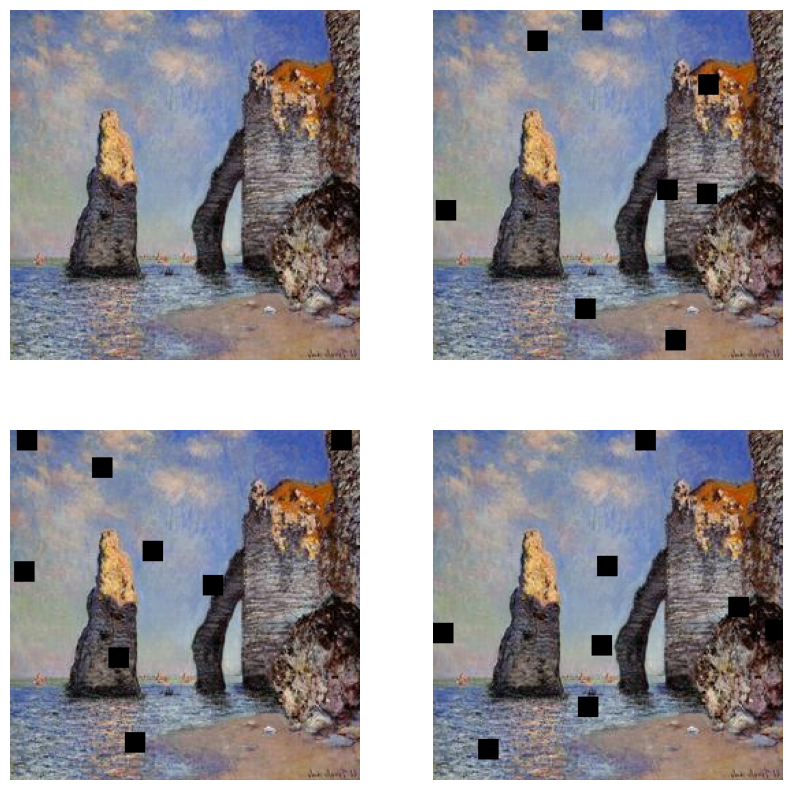

In [ ]:
# cut out or hide some pixels in the image
transform = A.Cutout(p=1.0, num_holes=8, max_h_size=15, max_w_size=15)

plot_multiple_augmentation("/content/drive/My Drive/monet_jpg/990ed28f62.jpg", transform)

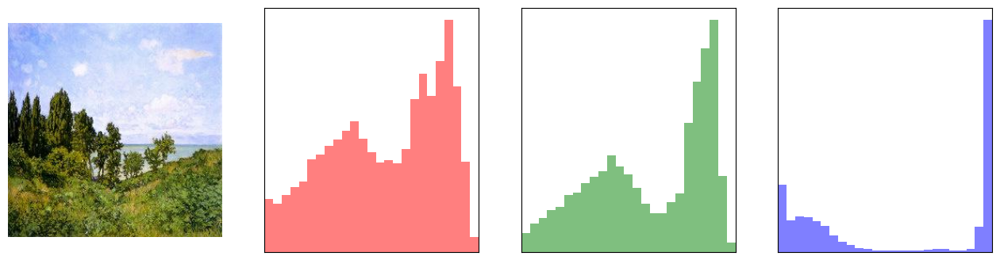

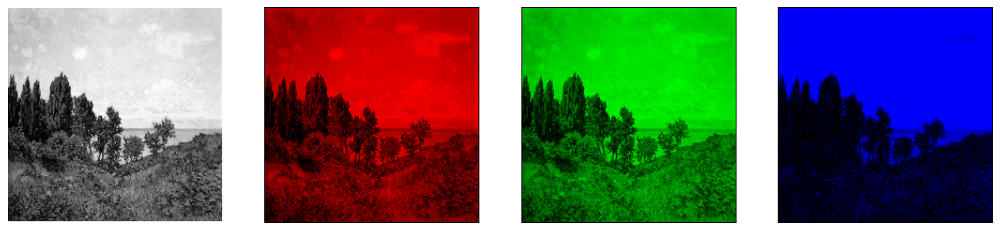

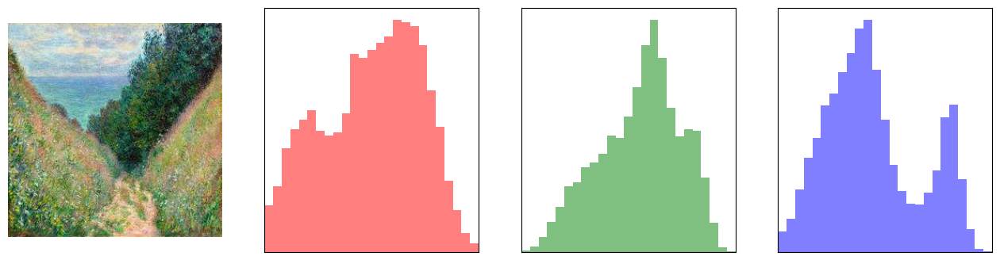

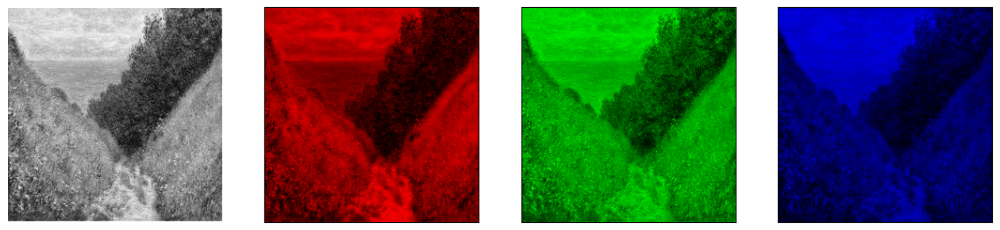

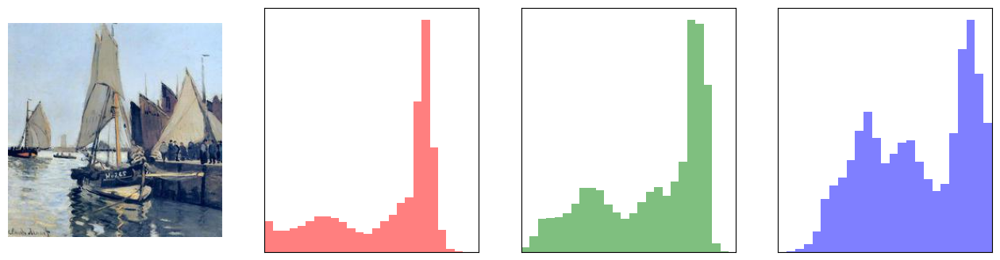

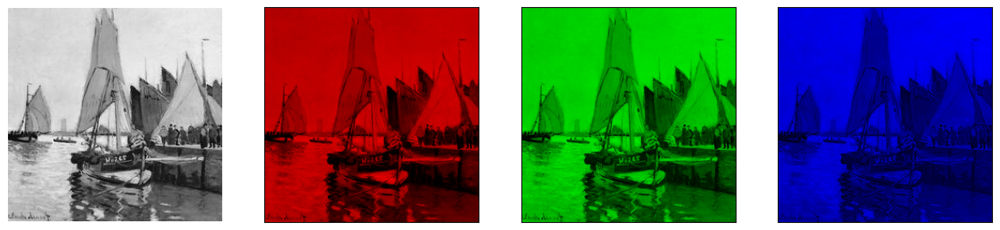

In [ ]:
# individual Channel visualisation, multiple images
def channels_visualization(image_path, figsize=(16, 4)):
    plt.figure(figsize=figsize)

    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(1, 4, 1)
    plt.imshow(np.mean(img, axis=2), cmap="gray")
    plt.axis('off')

    for i in range(3):
        plt.subplot(1, 4, i + 2)
        tmp_img = np.full_like(img, 0)
        tmp_img[:, :, i] = img[:, :, i]
        plt.imshow(tmp_img)
        plt.xlim(0, 255)
        plt.xticks([])
        plt.yticks([])


    plt.show()



def color_hist_visualization(image_path, figsize=(16, 4)):
    plt.figure(figsize=figsize)

    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(1, 4, 1)
    plt.imshow(img)
    plt.axis("off")

    colors = ["red", "green", "blue"]
    for i in range(len(colors)):
        plt.subplot(1, 4, i + 2)
        plt.hist(
            img[:, :, i].reshape(-1),
            bins=25,
            alpha=0.5,
            color=colors[i],
            density=True
        )
        plt.xlim(0, 255)
        plt.xticks([])
        plt.yticks([])


    plt.show()


img_path = '/content/drive/My Drive/monet_jpg/51db3fc011.jpg'
color_hist_visualization(img_path)
channels_visualization(img_path)

img_path = '/content/drive/My Drive/monet_jpg/1814cc6632.jpg'
color_hist_visualization(img_path)
channels_visualization(img_path)

img_path = '/content/drive/My Drive/monet_jpg/4995c04b1a.jpg'
color_hist_visualization(img_path)
channels_visualization(img_path)

